###### Problem Statement

- Prepare a classification model using SVM for salary data.

In [1]:
#Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score,precision_score,recall_score,f1_score

%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

- Dataset(Train):- SalaryData_Train(1)
- Dataset(Test):- SalaryData_Test(1)

###### 1) Training data

In [2]:
#Read training data
train_data = pd.read_csv('SalaryData_Train(1).csv')
train_data

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,39,State-gov,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30156,27,Private,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
30157,40,Private,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
30158,58,Private,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
30159,22,Private,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


###### EDA (Training data)

In [3]:
train_data.shape

(30161, 14)

In [4]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30161 entries, 0 to 30160
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   age            30161 non-null  int64 
 1   workclass      30161 non-null  object
 2   education      30161 non-null  object
 3   educationno    30161 non-null  int64 
 4   maritalstatus  30161 non-null  object
 5   occupation     30161 non-null  object
 6   relationship   30161 non-null  object
 7   race           30161 non-null  object
 8   sex            30161 non-null  object
 9   capitalgain    30161 non-null  int64 
 10  capitalloss    30161 non-null  int64 
 11  hoursperweek   30161 non-null  int64 
 12  native         30161 non-null  object
 13  Salary         30161 non-null  object
dtypes: int64(5), object(9)
memory usage: 3.2+ MB


In [5]:
train_data.describe()

,age,educationno,capitalgain,capitalloss,hoursperweek
count,30161.000000,30161.000000,30161.000000,30161.000000,30161.000000
mean,38.438115,10.121316,1092.044064,88.302311,40.931269
std,13.134830,2.550037,7406.466611,404.121321,11.980182
min,17.000000,1.000000,0.000000,0.000000,1.000000
25%,28.000000,9.000000,0.000000,0.000000,40.000000
50%,37.000000,10.000000,0.000000,0.000000,40.000000
75%,47.000000,13.000000,0.000000,0.000000,45.000000
max,90.000000,16.000000,99999.000000,4356.000000,99.000000


In [6]:
train_data.describe(include="O")

,workclass,education,maritalstatus,occupation,relationship,race,sex,native,Salary
count,30161,30161,30161,30161,30161,30161,30161,30161,30161
unique,7,16,7,14,6,5,2,40,2
top,Private,HS-grad,Married-civ-spouse,Prof-specialty,Husband,White,Male,United-States,<=50K
freq,22285,9840,14065,4038,12463,25932,20380,27504,22653


In [7]:
#Checking null entries.
train_data.isna().sum()

age              0
workclass        0
education        0
educationno      0
maritalstatus    0
occupation       0
relationship     0
race             0
sex              0
capitalgain      0
capitalloss      0
hoursperweek     0
native           0
Salary           0
dtype: int64

In [8]:
#Checking duplicate entries.
train_data[train_data.duplicated(keep=False)]

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
12,23,Private,Bachelors,13,Never-married,Adm-clerical,Own-child,White,Female,0,0,30,United-States,<=50K
16,32,Private,HS-grad,9,Never-married,Machine-op-inspct,Unmarried,White,Male,0,0,40,United-States,<=50K
19,40,Private,Doctorate,16,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,60,United-States,>50K
25,19,Private,HS-grad,9,Never-married,Craft-repair,Own-child,White,Male,0,0,40,United-States,<=50K
27,49,Private,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,0,0,40,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30110,47,Private,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,0,0,40,United-States,<=50K
30118,20,Private,HS-grad,9,Never-married,Machine-op-inspct,Own-child,White,Male,0,0,40,United-States,<=50K
30132,22,Private,Some-college,10,Never-married,Adm-clerical,Own-child,White,Male,0,0,40,United-States,<=50K
30157,40,Private,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K


In [9]:
#Drop duplicate entries.
train_data.drop_duplicates(keep='first', inplace=True)
train_data

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,39,State-gov,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30154,53,Private,Masters,14,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,40,United-States,>50K
30155,22,Private,Some-college,10,Never-married,Protective-serv,Not-in-family,White,Male,0,0,40,United-States,<=50K
30156,27,Private,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
30158,58,Private,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K


In [10]:
train_data.groupby('workclass', axis=0).mean()

,age,educationno,capitalgain,capitalloss,hoursperweek
workclass,,,,,
Federal-gov,42.588805,10.955867,844.864370,113.415501,41.315393
Local-gov,41.842602,11.023833,851.052135,113.226415,40.986594
Private,37.403841,9.868735,1009.758861,91.766044,40.489512
Self-emp-inc,46.067684,11.181125,4896.753098,153.061964,48.831268
Self-emp-not-inc,45.093789,10.218840,1966.648704,118.117236,44.382970
State-gov,39.462091,11.353551,698.505986,82.831604,39.122107
Without-pay,47.785714,9.071429,487.857143,0.000000,32.714286


- Visualisation (Training data)

In [11]:
plt.rcParams['figure.figsize'] = (10,5)
plt.rcParams['figure.dpi'] = 250

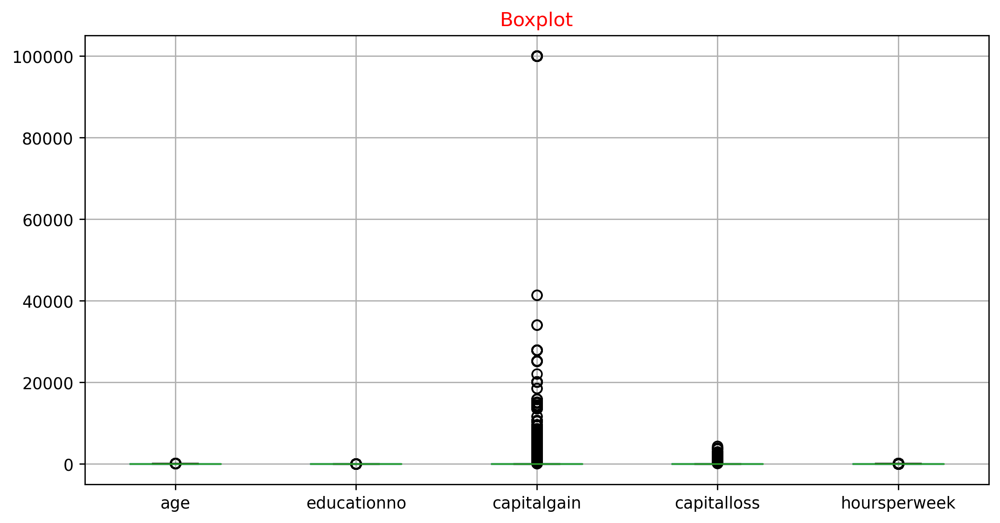

In [12]:
train_data.boxplot()
plt.title('Boxplot', c='r');

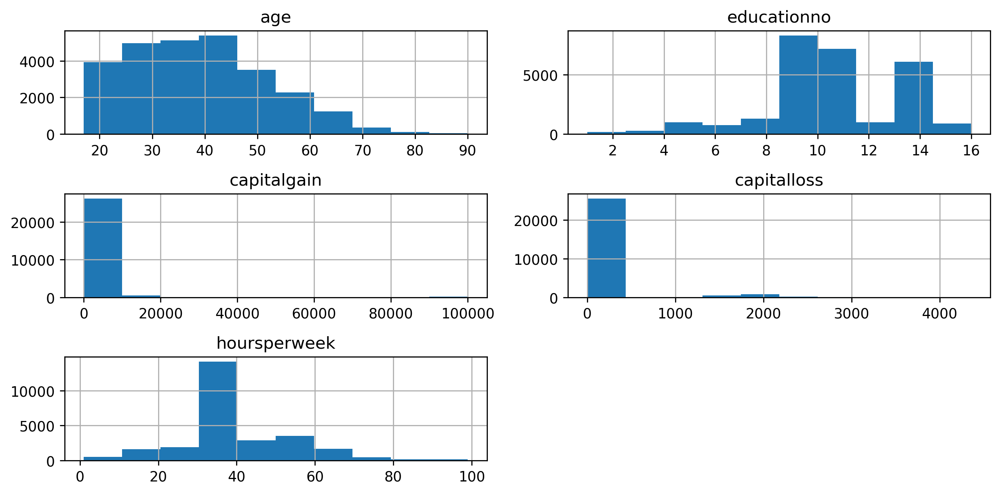

In [13]:
#Histogram
train_data.hist();
plt.tight_layout()

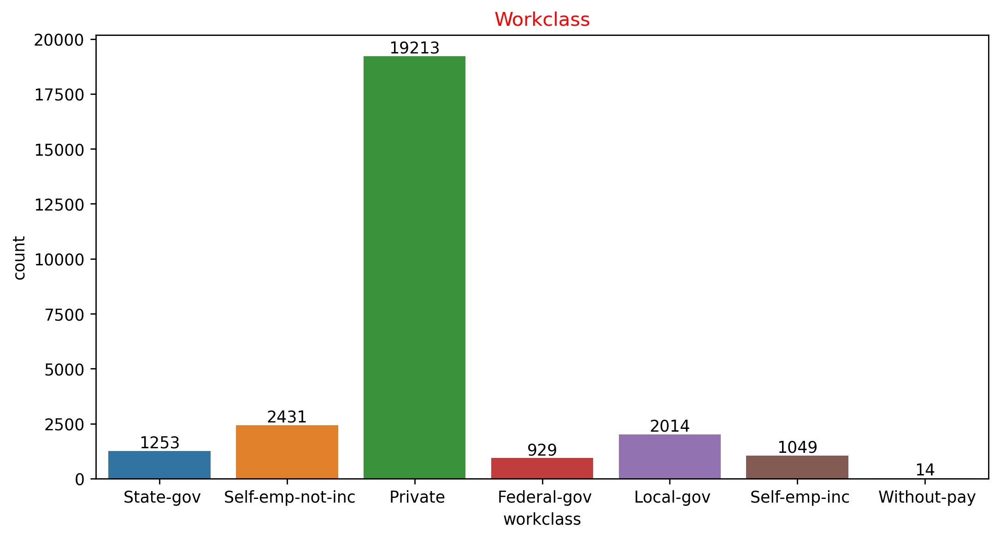

In [14]:
ax = sns.countplot('workclass', data = train_data)
ax.bar_label(ax.containers[0]);
plt.title('Workclass', c='r');

In [15]:
x = pd.DataFrame()
x['education'] = train_data['education'].unique()
x['educationno'] = train_data['educationno'].unique()

x.sort_values('educationno',inplace=True)
x.reset_index(drop=True, inplace=True)
x

,education,educationno
0,Preschool,1
1,1st-4th,2
2,5th-6th,3
3,7th-8th,4
4,9th,5
5,10th,6
6,11th,7
7,12th,8
8,HS-grad,9
9,Some-college,10


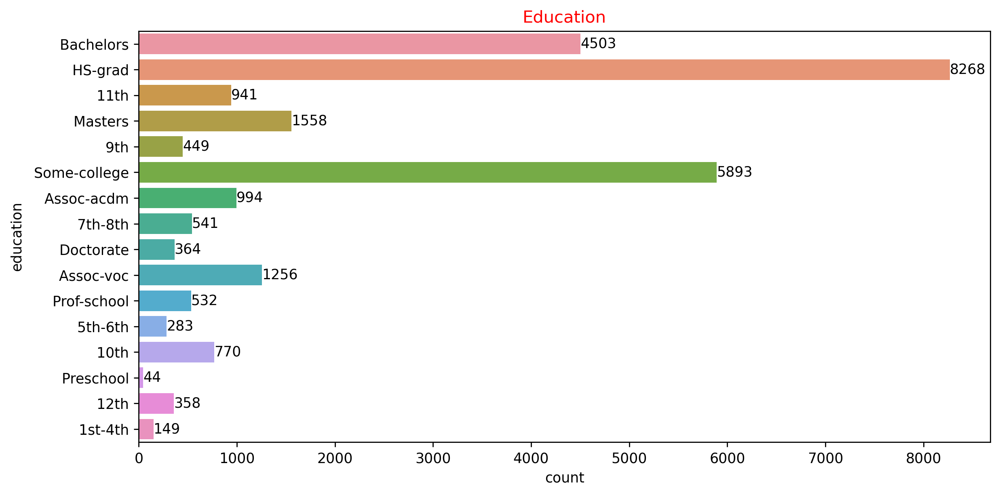

In [16]:
ax = sns.countplot(y='education', data = train_data)
ax.bar_label(ax.containers[0]);
plt.title('Education', c='r');
plt.tight_layout()

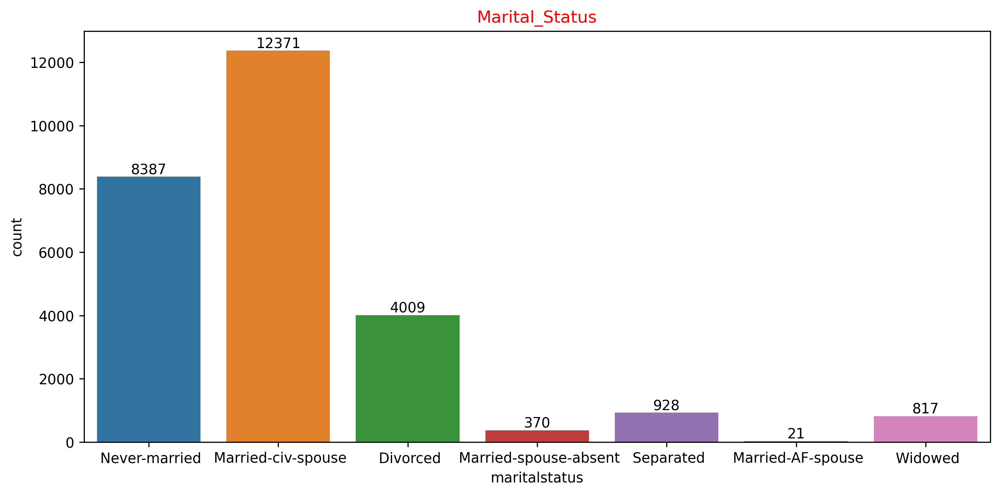

In [17]:
ax = sns.countplot('maritalstatus', data = train_data, )
ax.bar_label(ax.containers[0]);
plt.title('Marital_Status', c='r');
plt.tight_layout()

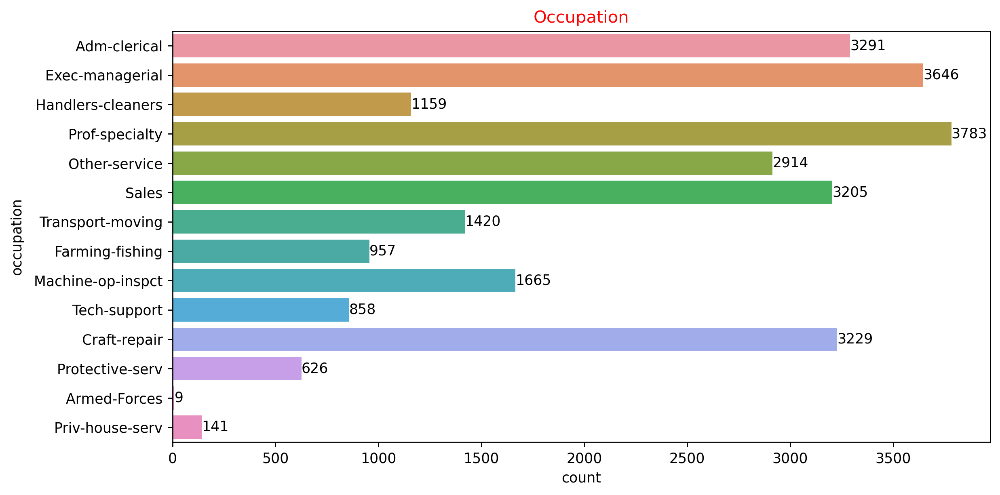

In [18]:
ax = sns.countplot(y='occupation', data = train_data)
ax.bar_label(ax.containers[0]);
plt.title('Occupation', c='r');
plt.tight_layout()

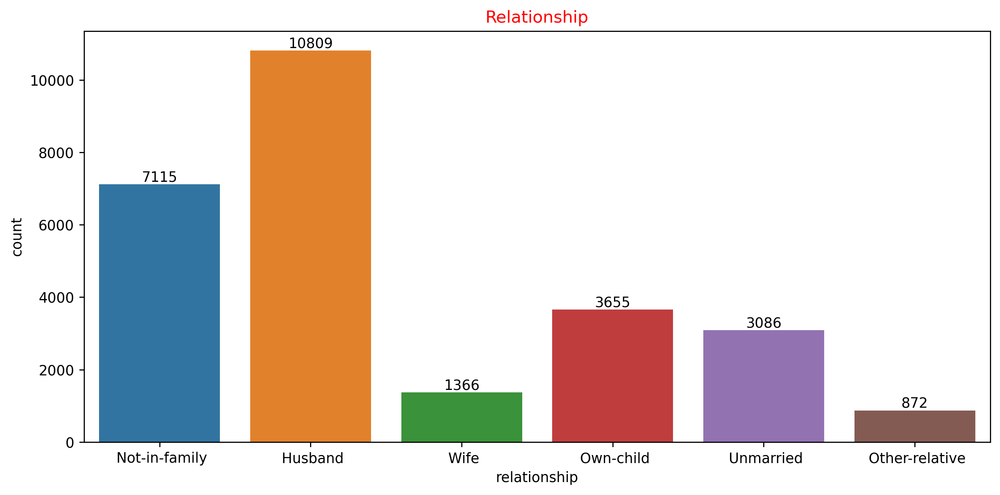

In [19]:
ax = sns.countplot('relationship', data = train_data)
ax.bar_label(ax.containers[0]);
plt.title('Relationship', c='r');
plt.tight_layout()

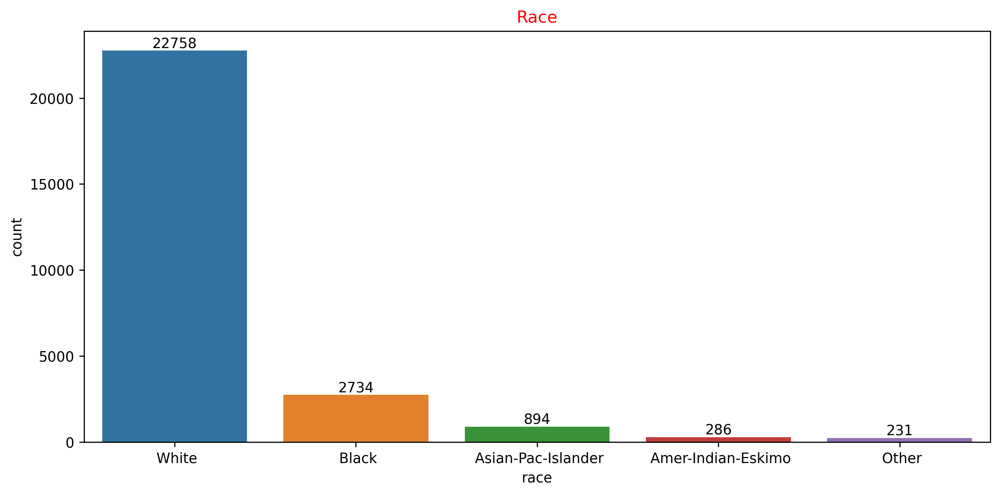

In [20]:
ax = sns.countplot('race', data = train_data)
ax.bar_label(ax.containers[0]);
plt.title('Race', c='r');
plt.tight_layout()

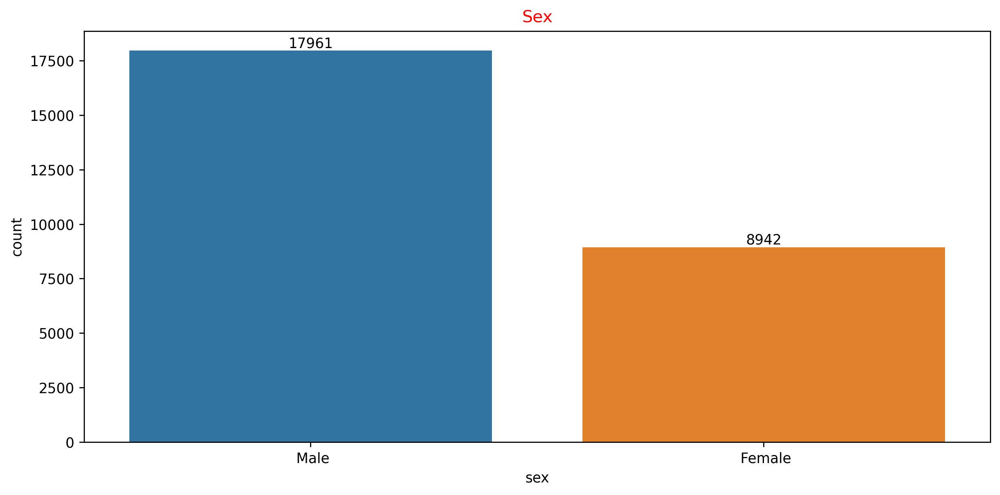

In [21]:
ax = sns.countplot('sex', data = train_data)
ax.bar_label(ax.containers[0]);
plt.title('Sex', c='r');
plt.tight_layout()

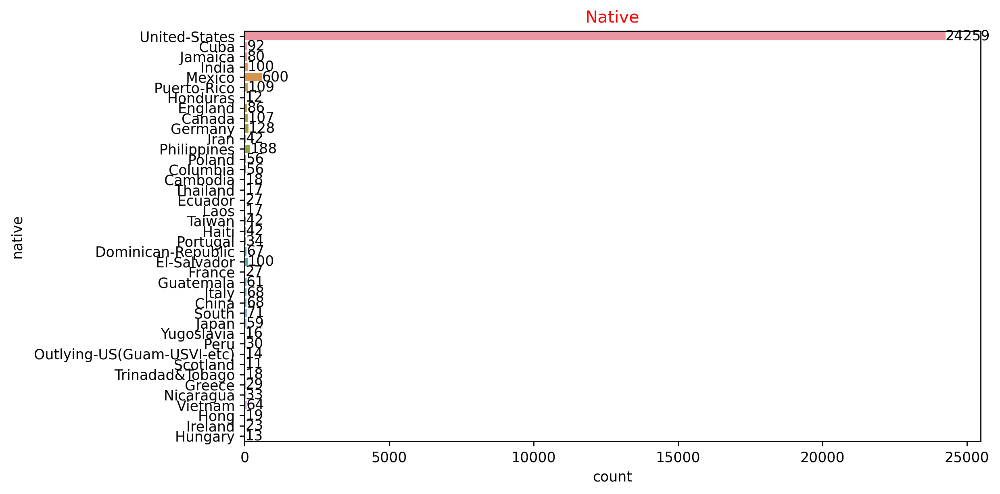

In [22]:
ax = sns.countplot(y='native', data = train_data)
ax.bar_label(ax.containers[0]);
plt.title('Native', c='r');
plt.tight_layout()

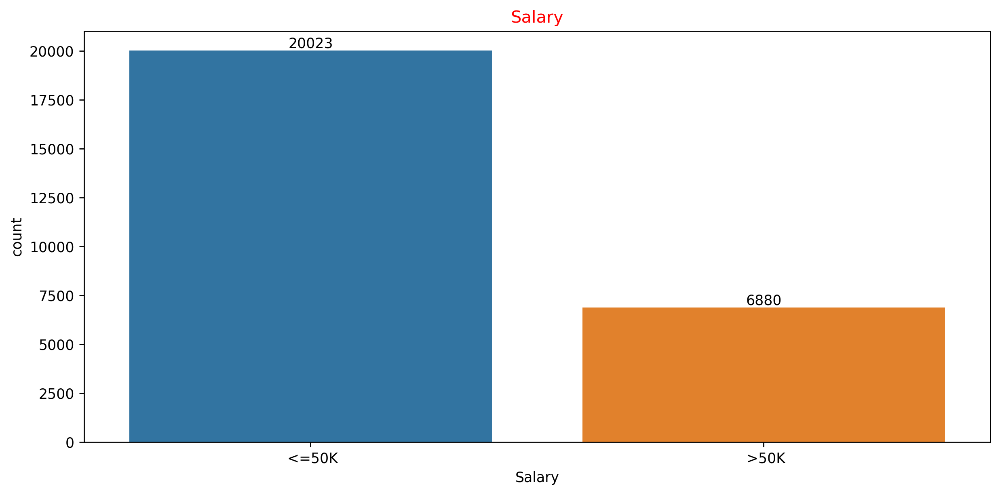

In [23]:
ax = sns.countplot('Salary', data = train_data)
ax.bar_label(ax.containers[0]);
plt.title('Salary', c='r');
plt.tight_layout()

In [24]:
#For education variable educationno is given, so droping education variable.
train_data.drop(columns='education', axis=1, inplace=True)

- Encoding

In [25]:
#Ordinal encoding for independent varaible.

oe = OrdinalEncoder()

train_data[['workclass', 'maritalstatus', 'occupation', 'relationship','race', 'sex', 'native']] = oe.fit_transform(train_data[['workclass', 'maritalstatus', 'occupation', 'relationship',
                                                                                                                                                                'race', 'sex', 'native']])

In [26]:
#Label encoding for target variable.

le = LabelEncoder()

train_data['Salary'] = le.fit_transform(train_data['Salary'])

In [27]:
#Training data after performing encoding.
train_data

,age,workclass,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,39,5.0,13,4.0,0.0,1.0,4.0,1.0,2174,0,40,37.0,0
1,50,4.0,13,2.0,3.0,0.0,4.0,1.0,0,0,13,37.0,0
2,38,2.0,9,0.0,5.0,1.0,4.0,1.0,0,0,40,37.0,0
3,53,2.0,7,2.0,5.0,0.0,2.0,1.0,0,0,40,37.0,0
4,28,2.0,13,2.0,9.0,5.0,2.0,0.0,0,0,40,4.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
30154,53,2.0,14,2.0,3.0,0.0,4.0,1.0,0,0,40,37.0,1
30155,22,2.0,10,4.0,10.0,1.0,4.0,1.0,0,0,40,37.0,0
30156,27,2.0,12,2.0,12.0,5.0,4.0,0.0,0,0,38,37.0,0
30158,58,2.0,9,6.0,0.0,4.0,4.0,0.0,0,0,40,37.0,0


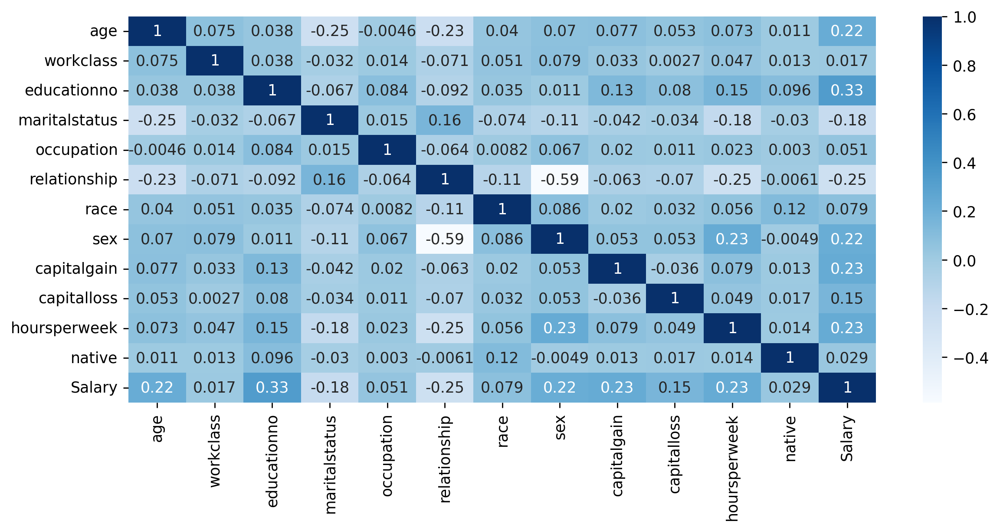

In [28]:
sns.heatmap(train_data.corr(), annot=True, cmap='Blues')
plt.tight_layout()

In [29]:
sns.pairplot(train_data, hue='Salary')

###### Testing data:-

In [30]:
#Read testing data.
test_data = pd.read_csv('SalaryData_Test(1).csv')
test_data

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,25,Private,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,34,Private,10th,6,Never-married,Other-service,Not-in-family,White,Male,0,0,30,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15055,33,Private,Bachelors,13,Never-married,Prof-specialty,Own-child,White,Male,0,0,40,United-States,<=50K
15056,39,Private,Bachelors,13,Divorced,Prof-specialty,Not-in-family,White,Female,0,0,36,United-States,<=50K
15057,38,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,50,United-States,<=50K
15058,44,Private,Bachelors,13,Divorced,Adm-clerical,Own-child,Asian-Pac-Islander,Male,5455,0,40,United-States,<=50K


###### EDA (Testing data)

In [31]:
test_data.shape

(15060, 14)

In [32]:
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15060 entries, 0 to 15059
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   age            15060 non-null  int64 
 1   workclass      15060 non-null  object
 2   education      15060 non-null  object
 3   educationno    15060 non-null  int64 
 4   maritalstatus  15060 non-null  object
 5   occupation     15060 non-null  object
 6   relationship   15060 non-null  object
 7   race           15060 non-null  object
 8   sex            15060 non-null  object
 9   capitalgain    15060 non-null  int64 
 10  capitalloss    15060 non-null  int64 
 11  hoursperweek   15060 non-null  int64 
 12  native         15060 non-null  object
 13  Salary         15060 non-null  object
dtypes: int64(5), object(9)
memory usage: 1.6+ MB


In [33]:
test_data.describe()

,age,educationno,capitalgain,capitalloss,hoursperweek
count,15060.000000,15060.000000,15060.000000,15060.000000,15060.000000
mean,38.768327,10.112749,1120.301594,89.041899,40.951594
std,13.380676,2.558727,7703.181842,406.283245,12.062831
min,17.000000,1.000000,0.000000,0.000000,1.000000
25%,28.000000,9.000000,0.000000,0.000000,40.000000
50%,37.000000,10.000000,0.000000,0.000000,40.000000
75%,48.000000,13.000000,0.000000,0.000000,45.000000
max,90.000000,16.000000,99999.000000,3770.000000,99.000000


In [34]:
test_data.describe(include='O')

,workclass,education,maritalstatus,occupation,relationship,race,sex,native,Salary
count,15060,15060,15060,15060,15060,15060,15060,15060,15060
unique,7,16,7,14,6,5,2,40,2
top,Private,HS-grad,Married-civ-spouse,Exec-managerial,Husband,White,Male,United-States,<=50K
freq,11021,4943,6990,1992,6203,12970,10147,13788,11360


In [35]:
#Checking null entries.
test_data.isna().sum()

age              0
workclass        0
education        0
educationno      0
maritalstatus    0
occupation       0
relationship     0
race             0
sex              0
capitalgain      0
capitalloss      0
hoursperweek     0
native           0
Salary           0
dtype: int64

In [36]:
#Checking Duplicates.
test_data[test_data.duplicated(keep=False)]

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
29,26,Private,HS-grad,9,Divorced,Exec-managerial,Unmarried,White,Female,0,0,40,United-States,<=50K
33,20,Private,HS-grad,9,Never-married,Craft-repair,Own-child,White,Male,0,0,40,United-States,<=50K
37,29,Private,11th,7,Married-civ-spouse,Other-service,Husband,White,Male,0,0,40,United-States,<=50K
44,18,Private,Some-college,10,Never-married,Other-service,Own-child,White,Male,0,0,20,United-States,<=50K
49,21,Private,Some-college,10,Never-married,Adm-clerical,Own-child,White,Female,0,0,40,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15043,51,Private,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,0,0,40,United-States,<=50K
15044,22,Private,Some-college,10,Never-married,Craft-repair,Own-child,White,Male,0,0,40,United-States,<=50K
15049,32,Private,HS-grad,9,Married-civ-spouse,Handlers-cleaners,Husband,White,Male,0,0,40,United-States,<=50K
15052,31,Private,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,0,0,40,United-States,<=50K


In [37]:
#Drop Duplicates.
test_data.drop_duplicates(keep='first', inplace=True)
test_data

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,25,Private,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,34,Private,10th,6,Never-married,Other-service,Not-in-family,White,Male,0,0,30,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15055,33,Private,Bachelors,13,Never-married,Prof-specialty,Own-child,White,Male,0,0,40,United-States,<=50K
15056,39,Private,Bachelors,13,Divorced,Prof-specialty,Not-in-family,White,Female,0,0,36,United-States,<=50K
15057,38,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,50,United-States,<=50K
15058,44,Private,Bachelors,13,Divorced,Adm-clerical,Own-child,Asian-Pac-Islander,Male,5455,0,40,United-States,<=50K


In [38]:
test_data.groupby('workclass').mean()

,age,educationno,capitalgain,capitalloss,hoursperweek
workclass,,,,,
Federal-gov,42.630435,10.800000,1119.450000,104.660870,41.756522
Local-gov,41.478859,10.990167,642.372665,88.825959,40.581121
Private,37.485204,9.851647,966.491024,89.229039,40.393273
Self-emp-inc,45.410619,11.214159,5577.902655,192.224779,48.205310
Self-emp-not-inc,46.107897,10.198593,1606.083659,98.466771,44.391712
State-gov,39.900602,11.361446,880.323795,83.980422,39.337349
Without-pay,46.285714,8.714286,0.000000,269.571429,36.428571


- Visualisation (Testing Data)

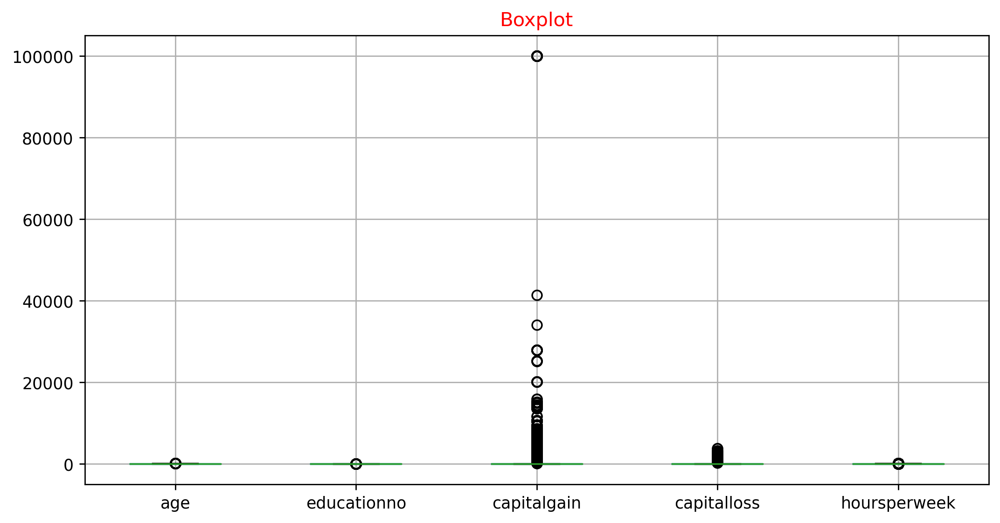

In [39]:
test_data.boxplot()
plt.title('Boxplot', c='r');

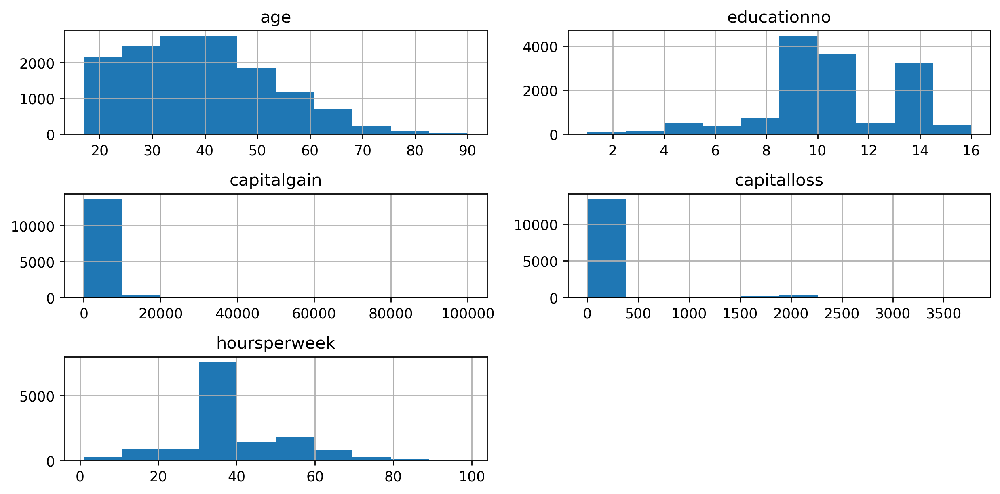

In [40]:
#Histogram.
test_data.hist();
plt.tight_layout()

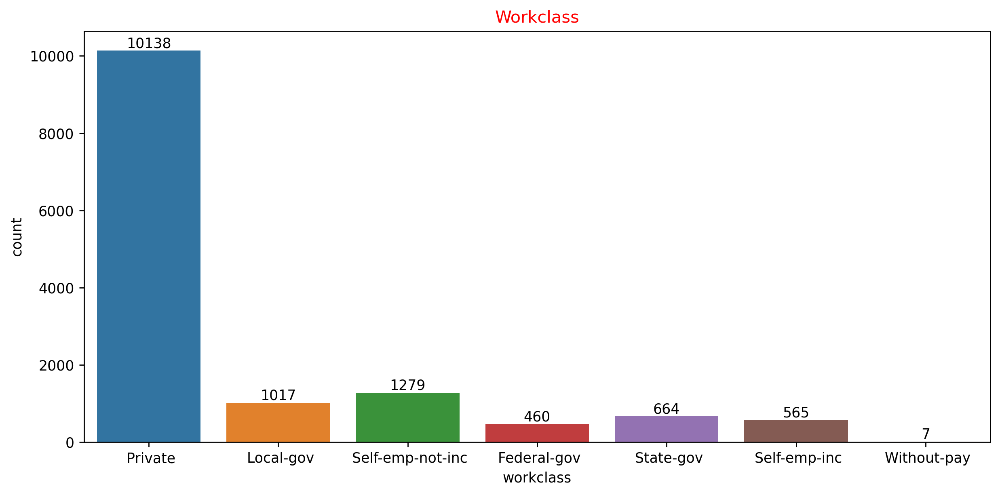

In [41]:
ax = sns.countplot('workclass', data=test_data)
ax.bar_label(ax.containers[0]);
plt.title('Workclass', c='r')
plt.tight_layout()

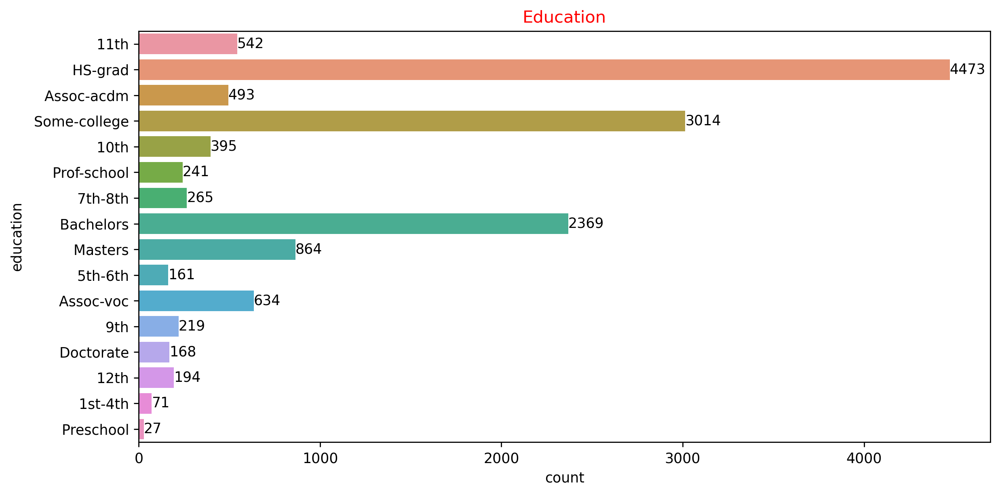

In [42]:
ax = sns.countplot(y='education', data=test_data)
ax.bar_label(ax.containers[0]);
plt.title('Education', c='r')
plt.tight_layout()

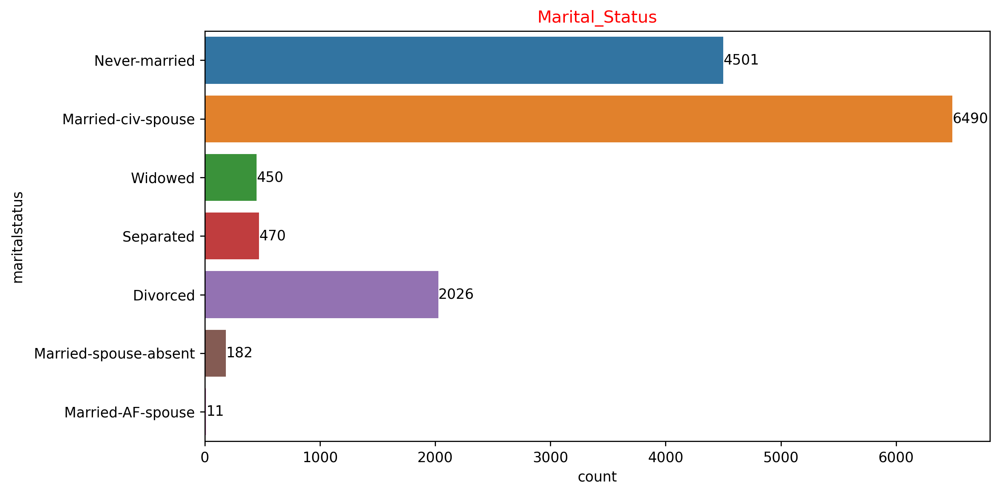

In [43]:
ax = sns.countplot(y='maritalstatus', data=test_data)
ax.bar_label(ax.containers[0]);
plt.title('Marital_Status', c='r')
plt.tight_layout()

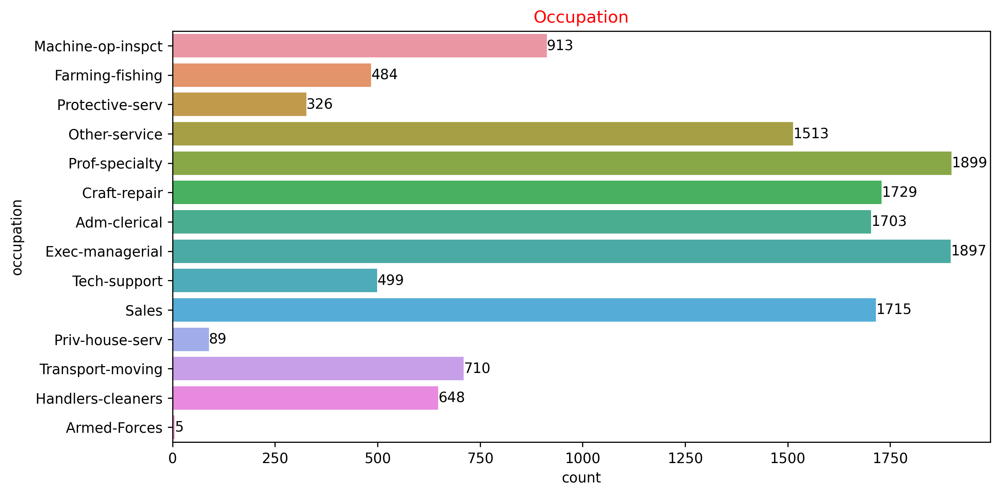

In [44]:
ax = sns.countplot(y='occupation', data=test_data)
ax.bar_label(ax.containers[0]);
plt.title('Occupation', c='r')
plt.tight_layout()

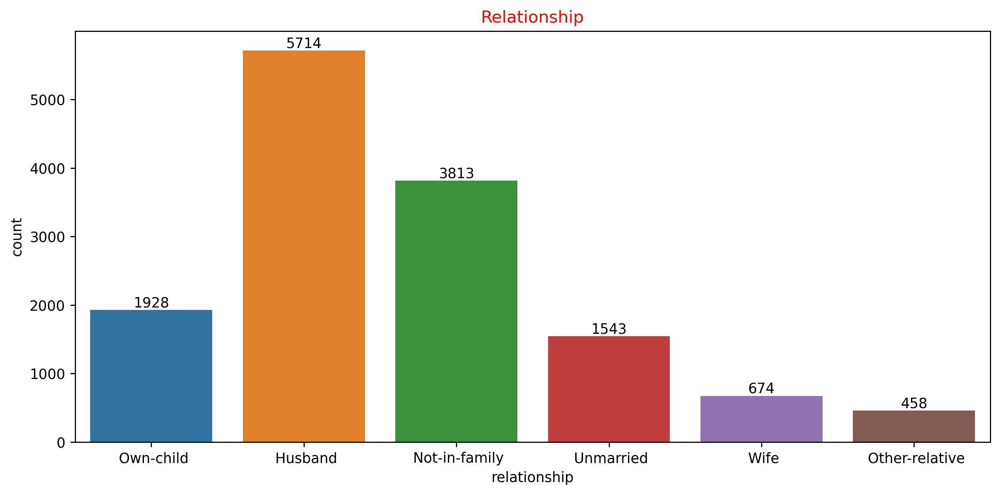

In [45]:
ax = sns.countplot('relationship', data=test_data)
ax.bar_label(ax.containers[0]);
plt.title('Relationship', c='r')
plt.tight_layout()

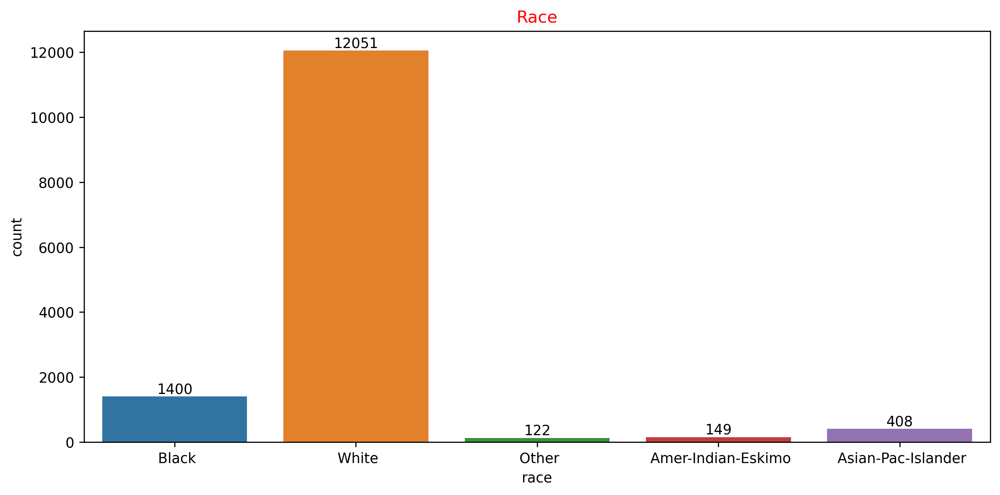

In [46]:
ax = sns.countplot('race', data=test_data)
ax.bar_label(ax.containers[0]);
plt.title('Race', c='r')
plt.tight_layout()

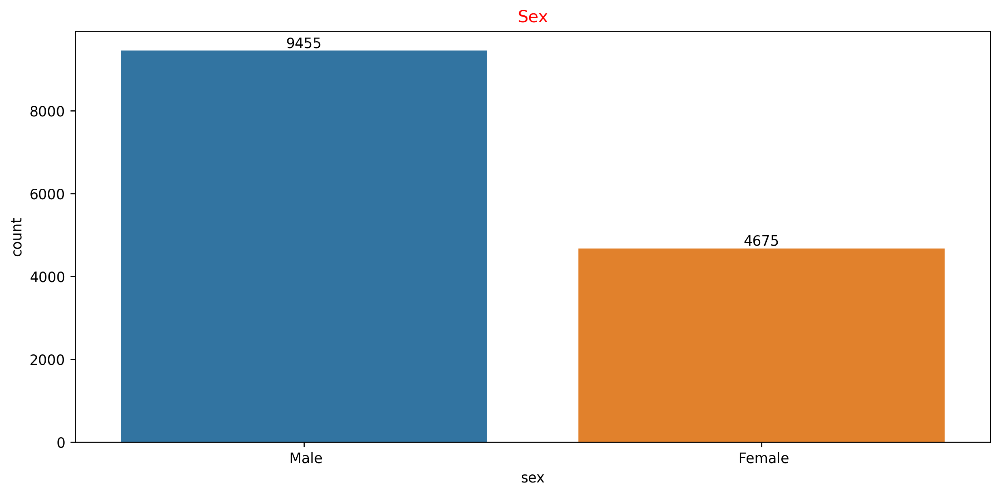

In [47]:
ax = sns.countplot('sex', data=test_data)
ax.bar_label(ax.containers[0]);
plt.title('Sex', c='r')
plt.tight_layout()

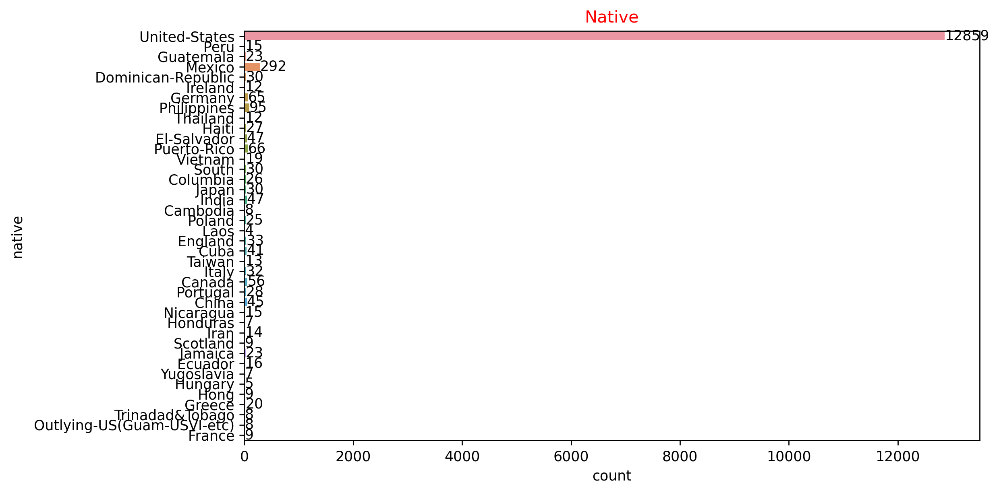

In [48]:
ax = sns.countplot(y='native', data=test_data)
ax.bar_label(ax.containers[0]);
plt.title('Native', c='r')
plt.tight_layout()

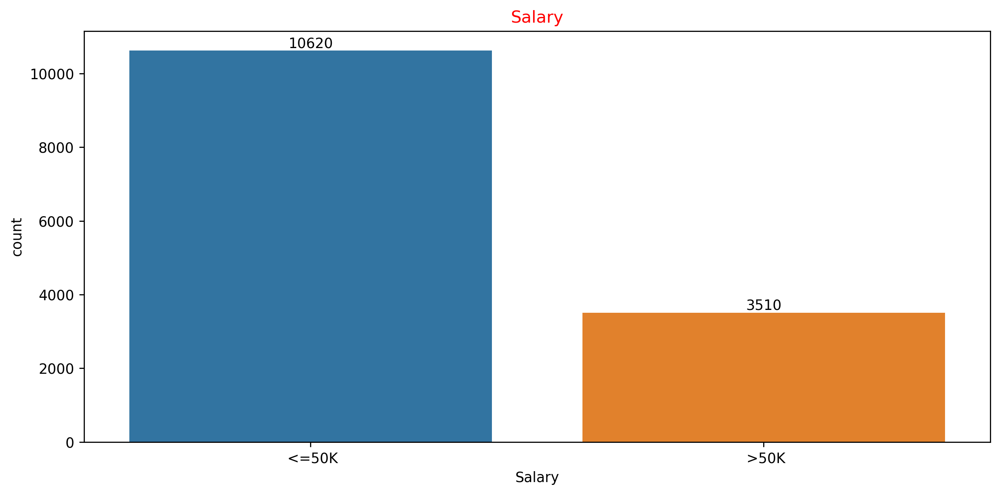

In [49]:
ax = sns.countplot('Salary', data=test_data)
ax.bar_label(ax.containers[0]);
plt.title('Salary', c='r')
plt.tight_layout()

In [50]:
#For education variable education no is given so droping education variable.
test_data.drop(columns='education', axis=1, inplace=True)

- Encoding

In [51]:
#Ordinal encoding for independent variable.

oe = OrdinalEncoder()

test_data[['workclass', 'maritalstatus', 'occupation', 'relationship', 'race', 'sex', 'native']] = oe.fit_transform(test_data[['workclass', 'maritalstatus', 'occupation', 'relationship', 'race',
                                                                                                                                                                               'sex', 'native']])

In [52]:
#Label encoding for target variable.

le = LabelEncoder()

test_data['Salary'] = le.fit_transform(test_data['Salary'])

In [53]:
#Testing data after performing encoding.
test_data

,age,workclass,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,25,2.0,7,4.0,6.0,3.0,2.0,1.0,0,0,40,37.0,0
1,38,2.0,9,2.0,4.0,0.0,4.0,1.0,0,0,50,37.0,0
2,28,1.0,12,2.0,10.0,0.0,4.0,1.0,0,0,40,37.0,1
3,44,2.0,10,2.0,6.0,0.0,2.0,1.0,7688,0,40,37.0,1
4,34,2.0,6,4.0,7.0,1.0,4.0,1.0,0,0,30,37.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
15055,33,2.0,13,4.0,9.0,3.0,4.0,1.0,0,0,40,37.0,0
15056,39,2.0,13,0.0,9.0,1.0,4.0,0.0,0,0,36,37.0,0
15057,38,2.0,13,2.0,9.0,0.0,4.0,1.0,0,0,50,37.0,0
15058,44,2.0,13,0.0,0.0,3.0,1.0,1.0,5455,0,40,37.0,0


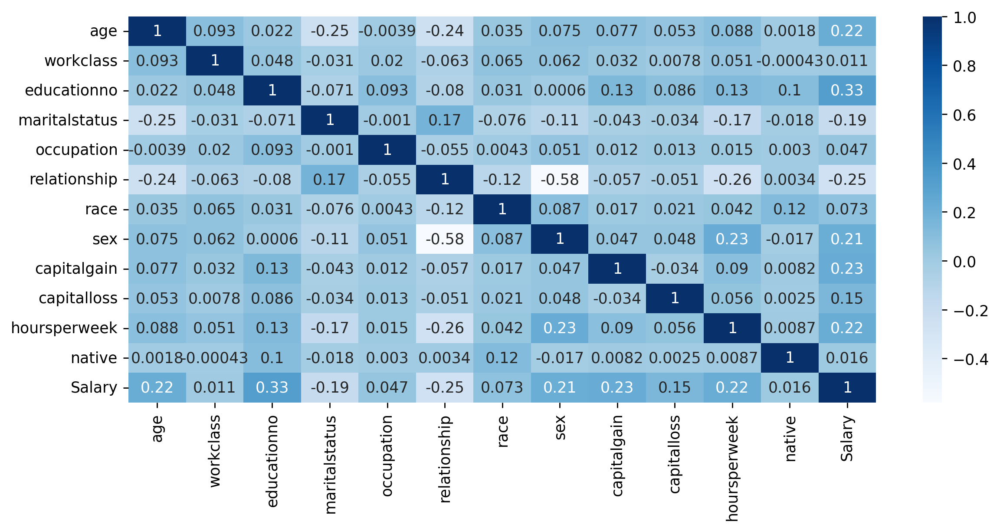

In [54]:
sns.heatmap(test_data.corr(), annot=True, cmap='Blues')
plt.tight_layout();

In [55]:
sns.pairplot(test_data, hue='Salary')

- Data splitting into training and testing

In [56]:
xtrain = train_data.iloc[:,0:-1]
xtest = test_data.iloc[:,0:-1]
ytrain = train_data['Salary']
ytest = test_data['Salary']

- Standardization

In [57]:
#Standardizing independent variables.
sc = StandardScaler()

xtrain = sc.fit_transform(xtrain)
xtest = sc.fit_transform(xtest)

###### Model Building

- kernel = linear

In [58]:
svc1 = SVC(kernel='linear')

svc1.fit(xtrain,ytrain)
ypred1 = svc1.predict(xtest)

print(classification_report(ytest,ypred1))

print('Training Accuracy = ', svc1.score(xtrain,ytrain))
print('Testing Accuracy = ', svc1.score(xtest,ytest))

              precision    recall  f1-score   support

           0       0.81      0.97      0.88     10620
           1       0.76      0.31      0.44      3510

    accuracy                           0.80     14130
   macro avg       0.79      0.64      0.66     14130
weighted avg       0.80      0.80      0.77     14130

Training Accuracy =  0.8050403300747129
Testing Accuracy =  0.8046001415428167


In [60]:
#Confusion matrix
cm = confusion_matrix(ytest,ypred1)
cm

array([[10276,   344],
       [ 2417,  1093]], dtype=int64)

- Kernel = poly

In [61]:
svc2 = SVC(kernel='poly')

svc2.fit(xtrain,ytrain)
ypred2 = svc2.predict(xtest)

print(classification_report(ytest,ypred2))

print('Training Accuracy = ', svc2.score(xtrain,ytrain))
print('Testing Accuracy = ', svc2.score(xtest,ytest))

              precision    recall  f1-score   support

           0       0.85      0.95      0.90     10620
           1       0.77      0.48      0.59      3510

    accuracy                           0.83     14130
   macro avg       0.81      0.72      0.74     14130
weighted avg       0.83      0.83      0.82     14130

Training Accuracy =  0.8347396201167157
Testing Accuracy =  0.8342533616418967


In [62]:
#Confusion matrix
cm = confusion_matrix(ytest,ypred2)
cm

array([[10109,   511],
       [ 1831,  1679]], dtype=int64)

- kernel = rbf

In [63]:
svc3 = SVC(kernel='rbf')

svc3.fit(xtrain,ytrain)
ypred3 = svc3.predict(xtest)

print(classification_report(ytest,ypred3))

print('Training Accuracy = ', svc3.score(xtrain,ytrain))
print('Testing Accuracy = ', svc3.score(xtest,ytest))

              precision    recall  f1-score   support

           0       0.86      0.94      0.90     10620
           1       0.76      0.54      0.63      3510

    accuracy                           0.84     14130
   macro avg       0.81      0.74      0.77     14130
weighted avg       0.84      0.84      0.83     14130

Training Accuracy =  0.846188157454559
Testing Accuracy =  0.8437367303609342


In [64]:
#Confusion matrix
cm = confusion_matrix(ytest,ypred3)
cm

array([[10014,   606],
       [ 1602,  1908]], dtype=int64)

In [65]:
Accuracy = accuracy_score(ytest,ypred3)
print('Accuracy = ', Accuracy)
Precision = precision_score(ytest,ypred3)
print('Precision = ', Precision)
Recall = recall_score(ytest,ypred3)
print('Recall = ', Recall)
F1_Score = f1_score(ytest,ypred3)
print('F1_Score = ', F1_Score)

Accuracy =  0.8437367303609342
Precision =  0.7589498806682577
Recall =  0.5435897435897435
F1_Score =  0.6334661354581673


- rbf kernel gives best accuracy as compaired to others.

## =======================================================================